# Brief overview of techniques covered in this tutorial

Normalization: Normalization / Scaling (often used interchangeably with standardization) is used to transform the actual values of numeric variables in a way that provides helpful properties for machine learning. Many algorithms such as Logistic Regression, Support Vector Machine, K Nearest Neighbors and Naive Bayes assume that all features are centered around zero and have variances that are at at the same level of order. If a particular feature in a dataset has a variance that is larger in order of magnitude than other features, the model may not understand all features correctly and could perform poorly. For instance, in the dataset we are using for this example the AGE feature ranges between 21 to 79 while other numeric features range from 10,000 to 1,000,000. Read more

Transformation: While normalization transforms the range of data to remove the impact of magnitude in variance, transformation is a more radical technique as it changes the shape of the distribution so that transformed data can be represented by a normal or approximate normal distirbution. In general, you should transform the data if using algorithms that assume normality or a gaussian distribution. Examples of such models are Logistic Regression, Linear Discriminant Analysis (LDA) and Gaussian Naive Bayes. (Pro tip: any method with “Gaussian” in the name probably assumes normality.) Read more

Ignore Low Variance: Datasets can sometimes contain categorical features that have a single unique or small number of values across samples. This kind of features are not only non-informative and add no value but are also sometimes harmful for few algorithms. Imagine a feature with only one unique value or few dominant unique values accross samples, they can be removed from the dataset by using the ignore low variance feature in PyCaret.

Multi-collinearity: Multi-collinearity is a state of very high intercorrelations or inter-associations among the independent features in the dataset. It is a type of disturbance in the data that is not handled well by machine learning models (mostly linear algorithms). Multi-collinearity may reduce overall coefficient of the model and cause unpredictable variance. This will lead to overfitting where the model may do great on a known training set but will fail with an unknown testing set. Read more

Group Features: Sometimes datasets may contain features that are related at a sample level. For example in the credit dataset there are features called BILL_AMT1 .. BILL_AMT6 which are related in such a way that BILL_AMT1 is the amount of the bill 1 month ago and BILL_AMT6 is the amount of the bill 6 months ago. Such features can be used to extract additional features based on the statistical properties of the distribution such as mean, median, variance, standard deviation etc.

Bin Numeric Variables: Binning or discretization is the process of transforming numerical variables into categorical features. An example would be the Age variable which is a continious distribution of numeric values that can be discretized into intervals (10-20 years, 21-30 etc.). Binning may improve the accuracy of a predictive model by reducing the noise or non-linearity in the data. PyCaret automatically determines the number and size of bins using Sturges rule. Read more

Model Ensembling and Stacking: Ensemble modeling is a process where multiple diverse models are created to predict an outcome. This is achieved either by using many different modeling algorithms or using different samples of training data sets. The ensemble model then aggregates the predictions of each base model resulting in one final prediction for the unseen data. The motivation for using ensemble models is to reduce the generalization error of the prediction. As long as the base models are diverse and independent, the prediction error of the model decreases when the ensemble approach is used. The two most common methods in ensemble learning are Bagging and Boosting. Stacking is also a type of ensemble learning where predictions from multiple models are used as input features for a meta model that predicts the final outcome. Read more


# 1. Getting Data

In [1]:
from pycaret.datasets import get_data
dataset = get_data('credit', profile=True)

Missing Values: There are no missing values in the data. However, we still need imputers in our pipeline just in case the new unseen data has missing values (not applicable in this case). When you execute the setup() function, imputers are created and stored in the pipeline automatically. By default, it uses a mean imputer for numeric values and a constant imputer for categorical. This can be changed using the numeric_imputation and categorical_imputation parameters in setup().

Multicollinearity: There are high correlations between BILL_AMT1 ... BIL_AMT6 which introduces multicollinearity into the data. We will remove multi-collinearity by using the remove_multicollinearity and multicollinearity_threshold parameters in setup.

Data Scale / Range: Notice how the scale / range of numeric features are different. For example the AGE feature ranges from between 21 to 79 and BILL_AMT1 ranges from -165,580 to 964,511. This may cause problems for algorithms that assume all features have variance within the same order. In this case, the order of magnitude for BILL_AMT1 is widely different than AGE. We will deal with this problem by using the normalize parameter in setup.

Distribution of Feature Space: Numeric features are not normally distributed. Look at the distributions of LIMIT_BAL, BILL_AMT1 and PAY_AMT1 ... PAY_AMT6. A few features are also highly skewed such as PAY_AMT1. This may cause problems for algorithms that assume normal or approximate normal distributions of the data. Examples include Logistic Regression, Linear Discriminant Analysis (LDA) and Naive Bayes. We will deal with this problem by using the transformation parameter in setup.

Group Features: From the data description we know that certain features are related with each other such as BILL_AMT1 ... BILL_AMT6 and PAY_AMT1 ... PAY_AMT6. We will use the group_features parameter in setup to extract statistical information from these features.

Bin Numeric Features: When looking at the correlations between the numeric features and the target variable, we that AGE and LIMIT_BAL are weak. We will use the bin_numeric_features parameter to remove the noise from these variables which may help linear algorithms.

In [2]:
#check the shape of data
dataset.shape

(24000, 24)

# 2. Keeping the validation test aside 

In [3]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions ' + str(data_unseen.shape))

Data for Modeling: (22800, 24)
Unseen Data For Predictions (1200, 24)


# 3. Setting up Environment in PyCaret

In [6]:
from pycaret.classification import *

In [8]:
exp_clf102 = setup(data = data, target = 'default', session_id=123,
                  normalize = True, 
                  transformation = True, 
                  ignore_low_variance = True,
                  remove_multicollinearity = True, multicollinearity_threshold = 0.95,
                  bin_numeric_features = ['LIMIT_BAL', 'AGE'],
                  group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
                                   ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
                  log_experiment = True, experiment_name = 'credit1')

Setup Succesfully Completed!


,Description,Value
0,session_id,123
1,Target Type,Binary
2,Label Encoded,"0: 0, 1: 1"
3,Original Data,"(22800, 24)"
4,Missing Values,False
5,Numeric Features,14
6,Categorical Features,9
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


Another difference you may have noticed is the log_experiment and experiment_name parameter we have used within setup. This is to log all the modeling activity in this experiment. You will see at the end of this notebook on how you can benefit from this functionality.

# 4. Comparing All Models

In [11]:
top3 = compare_models(n_select = 3)

#n_select parameter to return top N models. In this example compare_models has returned Top 3 models.

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
0,Gradient Boosting Classifier,0.8239,0.7874,0.3677,0.6930,0.4802,0.3860,0.4143,8.9429
1,Ridge Classifier,0.8236,0.0000,0.3643,0.6931,0.4774,0.3834,0.4123,0.0425
2,Linear Discriminant Analysis,0.8224,0.7781,0.3796,0.6762,0.4860,0.3887,0.4126,0.2859
3,SVM - Linear Kernel,0.8219,0.0000,0.3343,0.7072,0.4537,0.3632,0.3998,0.4346
4,Light Gradient Boosting Machine,0.8219,0.7822,0.3844,0.6699,0.4884,0.3900,0.4121,0.4724
5,Logistic Regression,0.8217,0.7804,0.3595,0.6857,0.4715,0.3766,0.4052,0.1962
6,CatBoost Classifier,0.8217,0.7869,0.3799,0.6720,0.4852,0.3873,0.4105,15.0442
7,Ada Boost Classifier,0.8191,0.7822,0.3380,0.6852,0.4524,0.3587,0.3910,2.1679
8,Extra Trees Classifier,0.8177,0.7618,0.3839,0.6491,0.4822,0.3803,0.3997,0.8951
9,Extreme Gradient Boosting,0.8131,0.7675,0.3703,0.6332,0.4670,0.3630,0.3824,2.8455


In [12]:
type(top3)

list

In [13]:
print(top3)

[GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd'

#### Notice how drastically a few of the algorithms have improved after we performed the pre-processing in setup().

Logistic Regression AUC improved from 0.6514 to 0.7804

Naives Bayes AUC improved from 0.6458 to 0.7533

K Nearest Neighbors AUC improved from 0.6097 to 0.7004

# 5. Create a Model

 In this section, we will create all models using 5 fold cross validation. Notice how the fold parameter is passed inside create_model() to achieve this.

In [15]:
#Create Model (with 5 fold CV)

dt = create_model('dt', fold = 5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7271,0.6175,0.4150,0.3901,0.4022,0.2256,0.2258
1,0.7353,0.6257,0.4263,0.4062,0.4160,0.2450,0.2451
2,0.7350,0.6253,0.4278,0.4059,0.4166,0.2452,0.2454
3,0.7409,0.6279,0.4235,0.4159,0.4196,0.2529,0.2529
4,0.7286,0.6232,0.4334,0.3964,0.4141,0.2379,0.2383
Mean,0.7334,0.6239,0.4252,0.4029,0.4137,0.2413,0.2415
SD,0.0050,0.0036,0.0060,0.0089,0.0060,0.0092,0.0091


In [16]:
# Create Model (Round Metrics to 2 decimals points)

rf = create_model('rf', round = 2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.81,0.72,0.32,0.63,0.43,0.33,0.35
1,0.81,0.74,0.30,0.64,0.41,0.31,0.34
2,0.81,0.77,0.35,0.62,0.44,0.34,0.36
3,0.80,0.72,0.31,0.61,0.41,0.30,0.33
4,0.81,0.72,0.32,0.65,0.43,0.33,0.36
5,0.81,0.73,0.33,0.64,0.44,0.34,0.36
6,0.80,0.71,0.32,0.58,0.41,0.30,0.32
7,0.81,0.74,0.34,0.66,0.45,0.35,0.38
8,0.81,0.71,0.32,0.62,0.43,0.32,0.35
9,0.80,0.73,0.33,0.60,0.42,0.32,0.34


# 6. Tune a Model

In [17]:
# Optimize the model for AUC instead of accuracy

tuned_rf = tune_model(rf, optimize = 'AUC')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8214,0.7836,0.3428,0.6954,0.4592,0.3667,0.3997
1,0.8246,0.8008,0.3428,0.7160,0.4636,0.3739,0.4103
2,0.8227,0.8232,0.3654,0.6862,0.4769,0.3819,0.4094
3,0.8177,0.7657,0.3484,0.6685,0.4581,0.3613,0.3890
4,0.8183,0.7775,0.3286,0.6864,0.4444,0.3516,0.3857
5,0.8183,0.7865,0.3343,0.6821,0.4487,0.3548,0.3872
6,0.8145,0.7557,0.3343,0.6592,0.4436,0.3463,0.3751
7,0.8308,0.7905,0.3484,0.7546,0.4767,0.3917,0.4335
8,0.8183,0.7599,0.3286,0.6864,0.4444,0.3516,0.3857
9,0.8150,0.7809,0.3598,0.6480,0.4627,0.3618,0.3847


In [18]:
# Optimise the model for recall

tuned_rf2 = tune_model(rf, optimize = 'Recall')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8258,0.7757,0.3994,0.6812,0.5036,0.4065,0.4278
1,0.8227,0.7859,0.3569,0.6923,0.4710,0.3773,0.4073
2,0.8289,0.8069,0.4306,0.6786,0.5269,0.4288,0.4453
3,0.8120,0.7477,0.3484,0.6373,0.4505,0.3487,0.3719
4,0.8139,0.7646,0.3456,0.6489,0.4510,0.3513,0.3766
5,0.8164,0.7688,0.3484,0.6613,0.4564,0.3585,0.3851
6,0.8120,0.7450,0.3484,0.6373,0.4505,0.3487,0.3719
7,0.8302,0.7817,0.3739,0.7253,0.4935,0.4037,0.4357
8,0.8189,0.7489,0.3654,0.6649,0.4717,0.3734,0.3977
9,0.8144,0.7649,0.3796,0.6351,0.4752,0.3710,0.3892


In [19]:
plot_model(tuned_rf, plot = 'parameter')

,Parameters
bootstrap,True
ccp_alpha,0
class_weight,None
criterion,gini
max_depth,10
max_features,auto
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0
min_impurity_split,None


In [20]:
plot_model(tuned_rf2, plot = 'parameter')

,Parameters
bootstrap,True
ccp_alpha,0
class_weight,None
criterion,gini
max_depth,30
max_features,auto
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0
min_impurity_split,None


# 7. Ensemble a Model

In [22]:
# lets create a simple decision tree model that we will use for ensembling 
dt = create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7243,0.6192,0.4306,0.3887,0.4086,0.2295,0.2300
1,0.7231,0.6137,0.4079,0.3820,0.3945,0.2152,0.2154
2,0.7287,0.6186,0.4193,0.3936,0.4060,0.2305,0.2307
3,0.7231,0.6064,0.3881,0.3774,0.3827,0.2042,0.2042
4,0.7199,0.6048,0.3966,0.3743,0.3851,0.2040,0.2041
5,0.7506,0.6435,0.4533,0.4384,0.4457,0.2849,0.2849
6,0.7249,0.6237,0.4448,0.3925,0.4170,0.2379,0.2387
7,0.7475,0.6341,0.4306,0.4294,0.4300,0.2678,0.2678
8,0.7350,0.6226,0.4193,0.4044,0.4117,0.2407,0.2408
9,0.7210,0.6211,0.4419,0.3861,0.4122,0.2303,0.2312


### Bagging

In [23]:
bagged_dt = ensemble_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8089,0.7344,0.3654,0.6143,0.4583,0.3512,0.3687
1,0.8083,0.7316,0.3314,0.6257,0.4333,0.3308,0.3550
2,0.8164,0.7508,0.4136,0.6293,0.4991,0.3926,0.4056
3,0.8058,0.7218,0.3484,0.6059,0.4424,0.3351,0.3539
4,0.8083,0.7299,0.3173,0.6328,0.4226,0.3226,0.3502
5,0.8083,0.7363,0.3428,0.6205,0.4416,0.3373,0.3590
6,0.7976,0.7280,0.3173,0.5773,0.4095,0.2996,0.3192
7,0.8076,0.7535,0.3399,0.6186,0.4388,0.3343,0.3562
8,0.8114,0.7233,0.3541,0.6313,0.4537,0.3505,0.3719
9,0.8107,0.7468,0.3654,0.6232,0.4607,0.3552,0.3738


In [24]:
# check the parameters of bagged_dt
print(bagged_dt)

BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=123,
 

### Boosting

In [26]:
boosted_dt = ensemble_model(dt, method = 'Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7989,0.7091,0.4051,0.5630,0.4712,0.3510,0.3583
1,0.7707,0.6921,0.3541,0.4753,0.4058,0.2675,0.2720
2,0.7870,0.7269,0.3966,0.5243,0.4516,0.3226,0.3274
3,0.7801,0.6666,0.3286,0.5043,0.3979,0.2707,0.2800
4,0.7675,0.6809,0.3598,0.4669,0.4064,0.2649,0.2684
5,0.7776,0.6959,0.3994,0.4965,0.4427,0.3058,0.3086
6,0.7726,0.6923,0.3626,0.4812,0.4136,0.2759,0.2802
7,0.7995,0.6737,0.3371,0.5805,0.4265,0.3152,0.3323
8,0.7751,0.6855,0.3853,0.4892,0.4311,0.2933,0.2966
9,0.7918,0.7170,0.3541,0.5459,0.4296,0.3093,0.3201


In [27]:
bagged_dt2 = ensemble_model(dt, n_estimators=50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8189,0.7542,0.3938,0.6495,0.4903,0.3881,0.4061
1,0.8189,0.7601,0.3711,0.6616,0.4755,0.3764,0.3994
2,0.8239,0.7851,0.4278,0.6565,0.5180,0.4161,0.4304
3,0.8089,0.7399,0.3654,0.6143,0.4583,0.3512,0.3687
4,0.8120,0.7580,0.3654,0.6293,0.4624,0.3580,0.3775
5,0.8202,0.7721,0.3853,0.6602,0.4866,0.3866,0.4072
6,0.8139,0.7456,0.3796,0.6321,0.4743,0.3697,0.3875
7,0.8264,0.7697,0.3881,0.6919,0.4973,0.4023,0.4268
8,0.8227,0.7438,0.3938,0.6683,0.4955,0.3966,0.4170
9,0.8125,0.7596,0.3966,0.6195,0.4836,0.3757,0.3897


### Blending

It uses predictions from multiple models to generate a final set of predictions using voting / majority consensus from all of the models passed in the estimator_list parameter. If no list is passed, PyCaret uses all of the models available in the model library by default. The method parameter can be used to define the type of voting. When set to hard, it uses labels for majority rule voting. When set to soft it uses the sum of predicted probabilities instead of the label. Let's see an example below:

In [28]:
blend_hard = blend_models()

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8258,0.0000,0.3796,0.6943,0.4908,0.3965,0.4228
1,0.8227,0.0000,0.3428,0.7035,0.4610,0.3696,0.4039
2,0.8264,0.0000,0.3994,0.6845,0.5045,0.4080,0.4297
3,0.8170,0.0000,0.3569,0.6597,0.4632,0.3645,0.3896
4,0.8277,0.0000,0.3598,0.7216,0.4802,0.3904,0.4245
5,0.8252,0.0000,0.3683,0.6989,0.4824,0.3891,0.4181
6,0.8202,0.0000,0.3569,0.6774,0.4675,0.3716,0.3993
7,0.8315,0.0000,0.3654,0.7414,0.4896,0.4023,0.4384
8,0.8214,0.0000,0.3626,0.6809,0.4732,0.3775,0.4047
9,0.8182,0.0000,0.3796,0.6537,0.4803,0.3794,0.4000


##### AUC is zero for all folds. This is because the method parameter is set to hard which only uses labels (1 or 0) for predictions and hence no AUC is calculated. To change this you would modify the method parameter inside blend_models()

In [29]:
blend_soft = blend_models(method = 'soft')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8239,0.7768,0.4079,0.6667,0.5062,0.4065,0.4247
1,0.8239,0.7817,0.3371,0.7169,0.4586,0.3693,0.4069
2,0.8214,0.8071,0.4419,0.6393,0.5226,0.4173,0.4280
3,0.8164,0.7653,0.3258,0.6765,0.4398,0.3457,0.3788
4,0.8214,0.7678,0.3173,0.7179,0.4401,0.3523,0.3940
5,0.8214,0.7921,0.3371,0.7000,0.4551,0.3636,0.3983
6,0.8195,0.7602,0.3371,0.6879,0.4525,0.3592,0.3921
7,0.8283,0.7885,0.3626,0.7232,0.4830,0.3934,0.4272
8,0.8208,0.7653,0.3484,0.6872,0.4624,0.3684,0.3990
9,0.8138,0.7693,0.3484,0.6474,0.4530,0.3528,0.3774


###  Normally, you would want to blend specific models and not all the models in the library. See example below where we blend top3 models obtained from compare_models as a list. We will simply pass top3 param inside blend_models.

In [30]:
blend_top3 = blend_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8214,0.0000,0.3654,0.6789,0.4751,0.3790,0.4055
1,0.8227,0.0000,0.3513,0.6966,0.4670,0.3743,0.4059
2,0.8258,0.0000,0.3938,0.6847,0.5000,0.4037,0.4264
3,0.8189,0.0000,0.3683,0.6633,0.4736,0.3749,0.3985
4,0.8258,0.0000,0.3626,0.7072,0.4794,0.3876,0.4188
5,0.8214,0.0000,0.3683,0.6771,0.4771,0.3805,0.4062
6,0.8208,0.0000,0.3598,0.6791,0.4704,0.3746,0.4020
7,0.8321,0.0000,0.3824,0.7297,0.5019,0.4125,0.4437
8,0.8239,0.0000,0.3654,0.6935,0.4787,0.3847,0.4134
9,0.8169,0.0000,0.3796,0.6473,0.4786,0.3766,0.3963


In [31]:
print(blend_top3.estimators_)

[GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd'

## Stacking

Stacking is another popular technique for ensembling but is less commonly implemented due to practical difficulties. Stacking is an ensemble learning technique that combines multiple models via a meta-model. Another way to think about stacking is that multiple models are trained to predict the outcome and a meta-model is created that uses the predictions from those models as an input along with the original features.

In [32]:
stack_soft = stack_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8239,0.7840,0.3683,0.6915,0.4806,0.3862,0.4141
1,0.8214,0.7968,0.3513,0.6889,0.4653,0.3714,0.4018
2,0.8271,0.8262,0.4023,0.6860,0.5071,0.4108,0.4323
3,0.8227,0.7889,0.3654,0.6862,0.4769,0.3819,0.4094
4,0.8258,0.7795,0.3626,0.7072,0.4794,0.3876,0.4188
5,0.8214,0.8033,0.3598,0.6828,0.4712,0.3760,0.4040
6,0.8183,0.7491,0.3513,0.6703,0.4610,0.3643,0.3918
7,0.8321,0.7912,0.3824,0.7297,0.5019,0.4125,0.4437
8,0.8208,0.7573,0.3456,0.6893,0.4604,0.3668,0.3983
9,0.8125,0.7816,0.3683,0.6311,0.4651,0.3609,0.3801


In [34]:
stack_hard = stack_models(top3, method='hard')

SystemExit: (Value Error): Method parameter not acceptable. It only accepts 'auto', 'predict_proba', 'decision_function', 'predict'.

In [43]:
%tb

SystemExit: (Value Error): Method parameter not acceptable. It only accepts 'auto', 'predict_proba', 'decision_function', 'predict'.

#### The soft method uses the sum of predicted probabilities and the hard method uses the label (1 or 0). In both of the examples above, the meta model (final model to generate predictions) is Logistic Regression (by default). The meta model can be changed using the meta_model parameter.

In [35]:
xgboost = create_model('xgboost')
stack_soft2 = stack_models(top3, meta_model=xgboost)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8164,0.7566,0.3853,0.6415,0.4814,0.3782,0.3964
1,0.8095,0.7804,0.3768,0.6129,0.4667,0.3587,0.3744
2,0.8195,0.7958,0.3768,0.6617,0.4801,0.3808,0.4029
3,0.8152,0.7536,0.3683,0.6436,0.4685,0.3665,0.3874
4,0.8158,0.7652,0.3711,0.6453,0.4712,0.3694,0.3901
5,0.8127,0.7672,0.3569,0.6364,0.4574,0.3548,0.3765
6,0.7995,0.7465,0.3513,0.5767,0.4366,0.3233,0.3380
7,0.8221,0.7763,0.3824,0.6716,0.4874,0.3894,0.4120
8,0.8127,0.7512,0.3654,0.6324,0.4632,0.3594,0.3793
9,0.8150,0.7766,0.3938,0.6318,0.4852,0.3798,0.3955


Selecting which method and models to use in stacking depends on the statistical properties of the dataset. Experimenting with different models and methods is the best way to find out which configuration will work best. However as a general rule of thumb, models with strong yet diverse performance tend to improve results when used in stacking. 

# 8. Model Calibration

When performing classification you often not only want to predict the class label (outcome such as 0 or 1), but also obtain the probability of the respective outcome which provides a level of confidence on the prediction. Some models can give you poor estimates of the class probabilities and some do not even support probability prediction. Well calibrated classifiers are probabilistic and provide outputs in the form of probabilities that can be directly interpreted as a confidence level. PyCaret allows you to calibrate the probabilities of a given model through the calibrate_model() function. See an example below:

In [36]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8089,0.7249,0.3201,0.6348,0.4256,0.3256,0.3531
1,0.8083,0.7406,0.2975,0.6442,0.4070,0.3106,0.3437
2,0.8089,0.7662,0.3456,0.6224,0.4444,0.3403,0.3618
3,0.8033,0.7198,0.3059,0.6102,0.4075,0.3049,0.3310
4,0.8120,0.7246,0.3201,0.6532,0.4297,0.3326,0.3629
5,0.8108,0.7349,0.3314,0.6393,0.4366,0.3363,0.3626
6,0.7989,0.7126,0.3173,0.5833,0.4110,0.3023,0.3227
7,0.8145,0.7412,0.3399,0.6557,0.4478,0.3495,0.3768
8,0.8070,0.7145,0.3229,0.6230,0.4254,0.3231,0.3484
9,0.8031,0.7322,0.3258,0.6021,0.4228,0.3166,0.3383


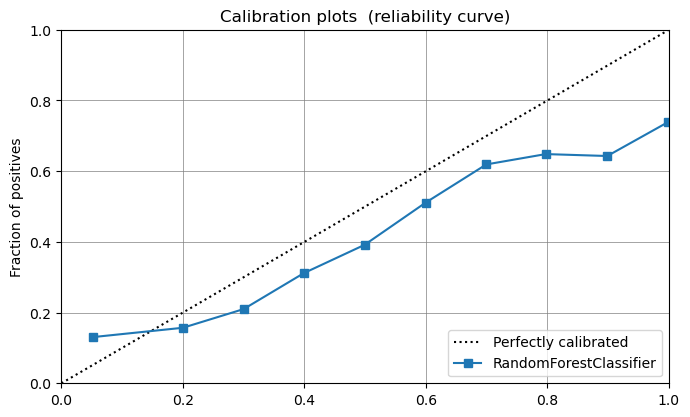

In [37]:
plot_model(rf, plot='calibration')

In [38]:
calibrated_rf = calibrate_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8183,0.7704,0.2833,0.7299,0.4082,0.3246,0.3756
1,0.8127,0.7778,0.2606,0.7077,0.3810,0.2973,0.3491
2,0.8195,0.8061,0.2720,0.7559,0.4000,0.3205,0.3788
3,0.8070,0.7509,0.2748,0.6510,0.3865,0.2937,0.3323
4,0.8120,0.7615,0.2663,0.6963,0.3852,0.2995,0.3480
5,0.8089,0.7772,0.2521,0.6846,0.3685,0.2832,0.3325
6,0.8108,0.7540,0.2776,0.6759,0.3936,0.3039,0.3463
7,0.8083,0.7735,0.2266,0.7080,0.3433,0.2644,0.3238
8,0.8139,0.7517,0.3003,0.6795,0.4165,0.3250,0.3635
9,0.8107,0.7807,0.2720,0.6809,0.3887,0.3003,0.3447


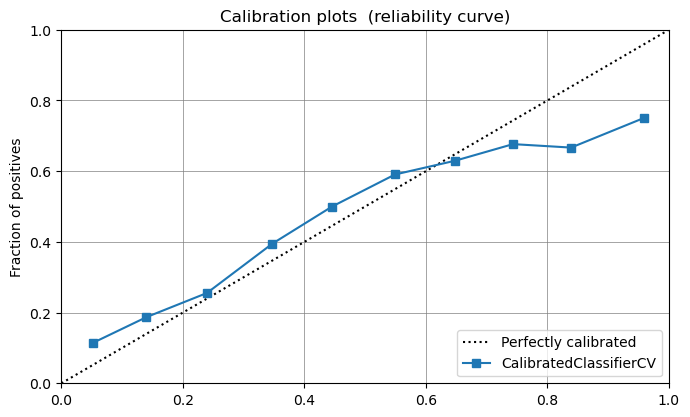

In [39]:
plot_model(calibrated_rf, plot='calibration')

Notice how different the above 2 plots look. One is before calibration and one is after. A perfectly calibrated classifier will follow the black dotted line in the above plots. Not only is calibrated_rf better calibrated but the AUC has also improved from 0.7344 to 0.7702. By default, calibrate_model() uses the sigmoid method which corresponds to Platt's approach. The other available method is isotonic which is a non-parametric approach. See an example of calibration using the isotonic method below:

In [40]:
calibrated_rf_isotonic = calibrate_model(rf, method = 'isotonic')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8189,0.7701,0.3059,0.7105,0.4277,0.3398,0.3825
1,0.8158,0.7795,0.2748,0.7185,0.3975,0.3135,0.3643
2,0.8189,0.8083,0.2833,0.7353,0.4090,0.3261,0.3781
3,0.8076,0.7478,0.2861,0.6474,0.3969,0.3023,0.3380
4,0.8127,0.7605,0.2861,0.6824,0.4032,0.3135,0.3553
5,0.8083,0.7775,0.2635,0.6691,0.3780,0.2892,0.3333
6,0.8139,0.7528,0.2946,0.6842,0.4119,0.3215,0.3620
7,0.8152,0.7735,0.2578,0.7339,0.3816,0.3012,0.3585
8,0.8170,0.7507,0.3116,0.6918,0.4297,0.3389,0.3772
9,0.8125,0.7782,0.2946,0.6753,0.4103,0.3186,0.3575


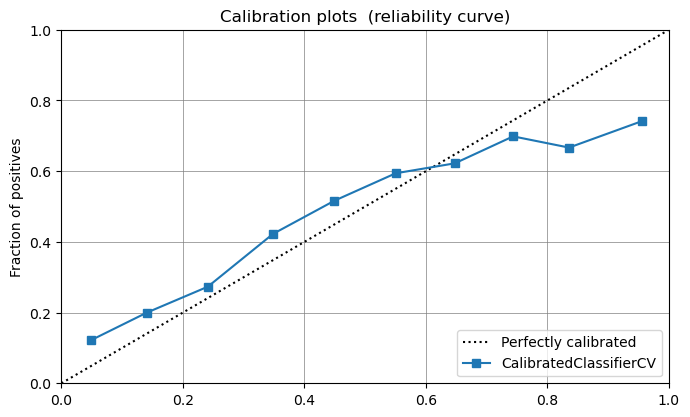

In [41]:
plot_model(calibrated_rf_isotonic, plot='calibration')

# 9. Experiment Logging

In [48]:
# to start the MLFlow server from notebook:
!mlflow ui

'mlflow' is not recognized as an internal or external command,
operable program or batch file.
